# Attention Distribution Plots

In [1]:
import os

import e2cnn

import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
from torchvision import transforms
import PIL

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import configparser as ConfigParser

import utils
# Ipmport various network architectures
from networks import AGRadGalNet, DNSteerableLeNet, DNSteerableAGRadGalNet #e2cnn module only works in python3.7+
# Import various data classes
from datasets import FRDEEPF
from datasets import MiraBest_full, MBFRConfident, MBFRUncertain, MBHybrid
from datasets import MingoLoTSS, MLFR, MLFRTest

from sklearn.metrics import classification_report, roc_curve, auc
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")


## Attention Maps for Selected Sources

In [2]:
def attention_plot(config, 
              plot=None, 
              path_supliment='', 
              marker='o', 
              alpha=0.7, 
              fontsize=14, 
              index=0, 
              mean=True,
              RGB=False,
              models_=[-1],
              device=torch.device('cpu')
             ):
    # Load in model and data
    model = utils.utils.load_model(config, load_model='best', device=device)
    test_data = utils.data.load(config, train=False, augmentation='None', data_loader=False)
    
    # Extract attention map
    sources = test_data.data.transpose(0,3,1,2)
    labels = np.asarray(test_data.targets)
    if RGB:
        mean_tmp = False
    else:
        mean_tmp = mean
    amap, amap_originals = utils.attention.attentions_func(sources, model, device=device, layer_no=3, layer_name_base='attention', mean=mean_tmp)
    predictions=None
    
    plt.rcParams.update({'font.size': fontsize})
    # Plot sources
    if type(plot)==list:
        source_nos = plot
    elif plot=='all':
        source_nos = list(range(sources.shape[0]))
    
    if plot != None:
        sources = test_data.data.squeeze()
        source_nos.sort()
        for idx in source_nos:
            source = sources[idx]/255
            amap_   = amap[idx]
            amap_37 = amap_originals[idx*3+0]
            amap_75 = amap_originals[idx*3+1]
            amap_150 = amap_originals[idx*3+2]
            if RGB:
                amap_ = amap_.transpose(1,2,0)
                tmp = np.zeros((3, 150, 150))
                tmp37 = np.zeros((37, 37))
                tmp75 = np.zeros((75, 75))
                tmp150 = np.zeros((150, 150))
                amap_37 = np.stack((amap_37.squeeze(), tmp37, tmp37), axis=2)
                amap_75 = np.stack((tmp75, amap_75.squeeze(), tmp75), axis=2)
                amap_150 = np.stack((tmp150, tmp150, amap_150.squeeze()), axis=2) 

            plt.figure(figsize=(20,10))
            plt.tight_layout()

            plt.subplot(151)
            plt.title(f"Test Image {idx}")
            plt.imshow(source, origin='lower', cmap='magma',vmax=1,vmin=0)
            plt.contour(sources[idx], 1, cmap='cool', alpha=0.5)
            plt.xticks([])
            plt.yticks([])

            plt.subplot(152)
            plt.title(f"Averaged Attention")
            plt.imshow(amap_, origin='lower', cmap='magma', vmax=1,vmin=0)
            plt.xticks([])
            plt.yticks([])

            plt.subplot(153)
            plt.title(f"1st Attention Gate")
            plt.imshow(amap_37, origin='lower', cmap='magma', vmax=1,vmin=0)
            plt.yticks([])

            plt.subplot(154)
            plt.title(f"2nd Attention Gate")
            plt.imshow(amap_75, origin='lower', cmap='magma', vmax=1,vmin=0)
            plt.yticks([])

            plt.subplot(155)
            plt.title(f"3rd Attention Gate")
            plt.imshow(amap_150, origin='lower', cmap='magma', vmax=1,vmin=0)
            plt.yticks([])
            
            plt.show()
        
    return amap, amap_originals, test_data, predictions

configs/e2attentionmirabest.cfg


/raid/scratch/mbowles/EquivariantSelfAttention/venv/lib/python3.8/site-packages/e2cnn/nn/modules/r2_conv/basisexpansion_singleblock.py:61: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /pytorch/aten/src/ATen/native/IndexingUtils.h:30.)
  sampled_basis = sampled_basis[mask, ...]
/raid/scratch/mbowles/EquivariantSelfAttention/venv/lib/python3.8/site-packages/torchvision/transforms/transforms.py:1314: UserWarning: Argument resample is deprecated and will be removed since v0.10.0. Please, use interpolation instead
  warnings.warn(
/raid/scratch/mbowles/EquivariantSelfAttention/venv/lib/python3.8/site-packages/torch/nn/functional.py:3451: UserWarning: Default upsampling behavior when mode=bilinear is changed to align_corners=False since 0.4.0. Please specify align_corners=True if the old behavior is desired. See the documentation of nn.Upsample for details.
  warnings.warn(


Files already downloaded and verified


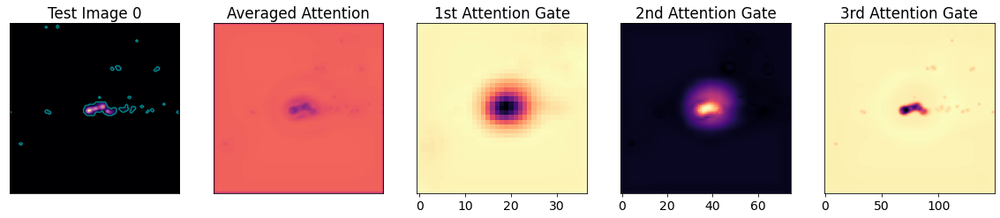

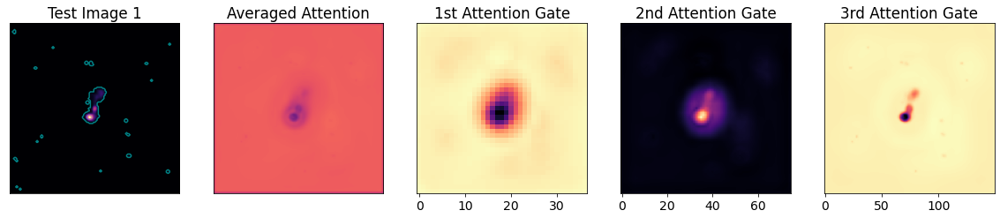

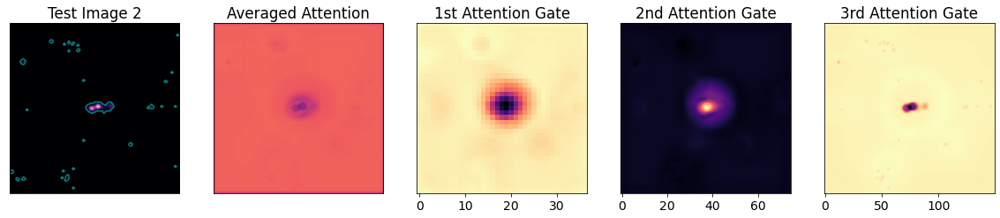

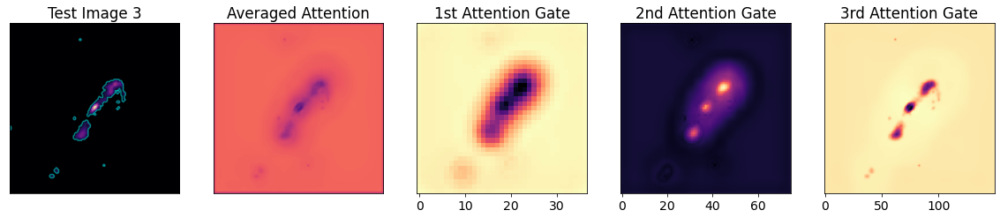

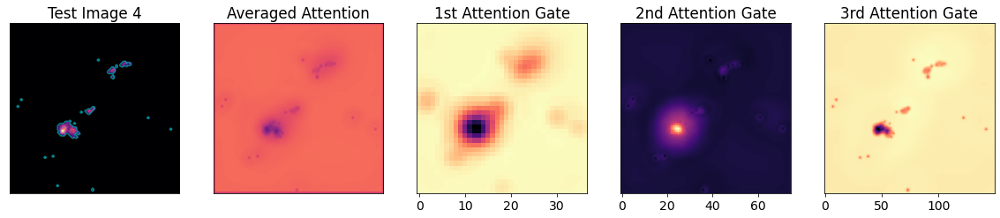

...

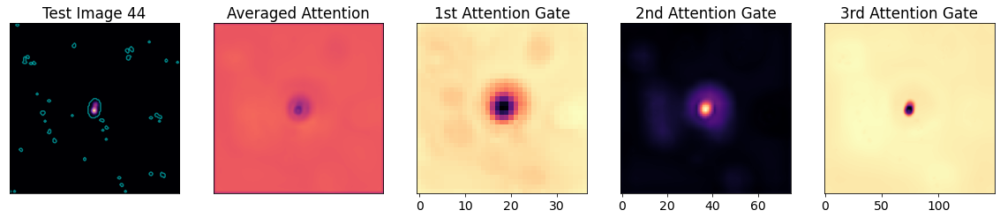

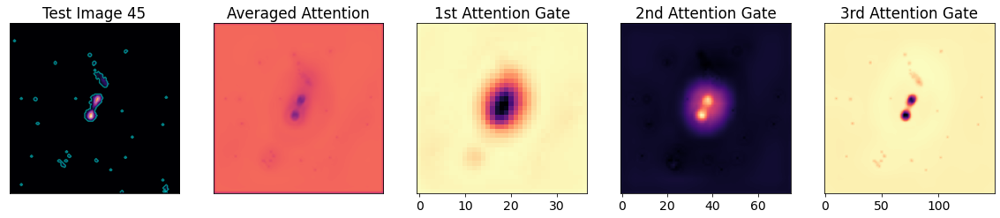

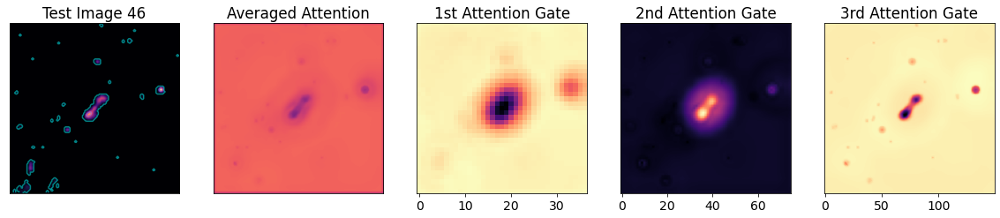

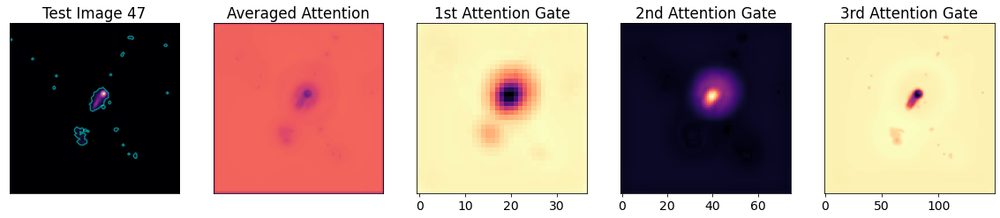

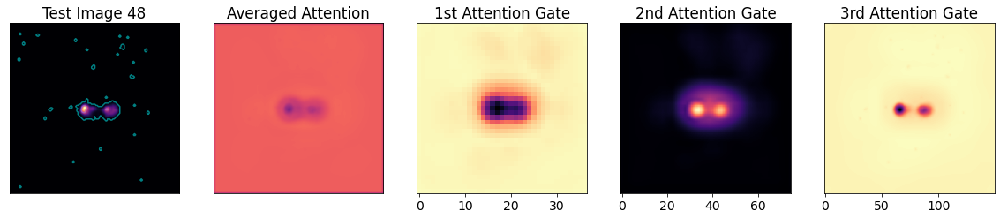

configs/e2attentionmingo.cfg
Files already downloaded and verified


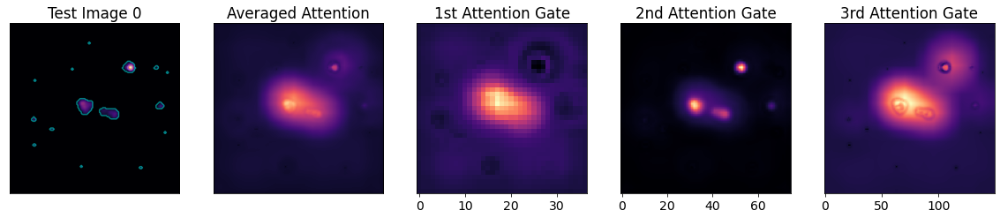

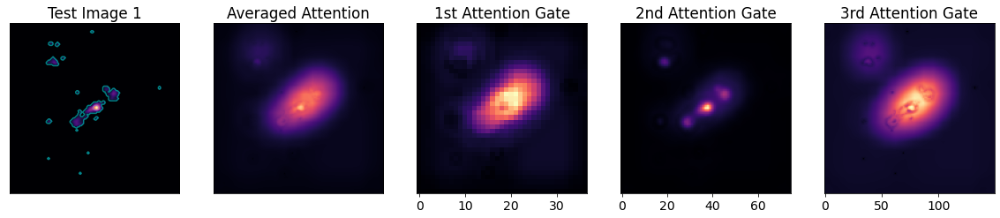

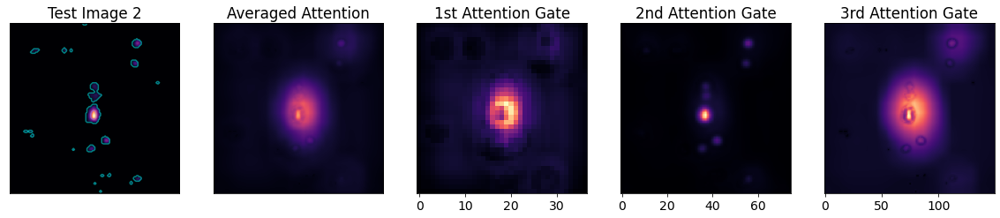

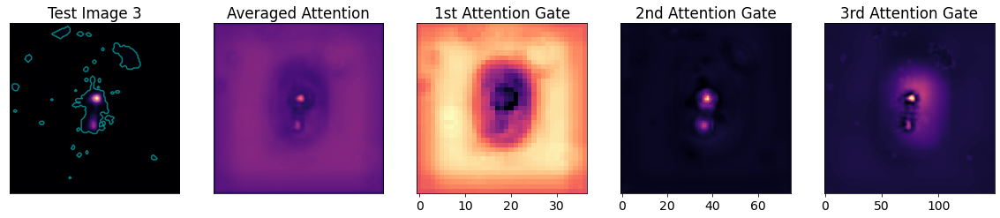

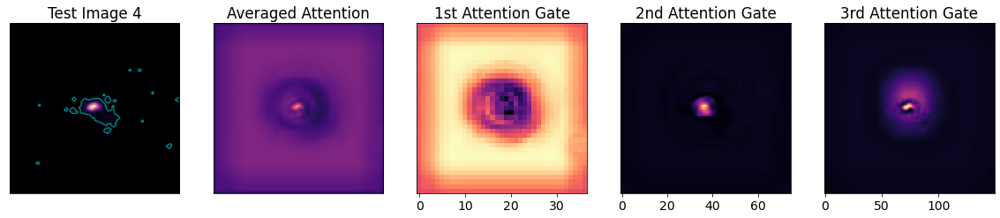

...

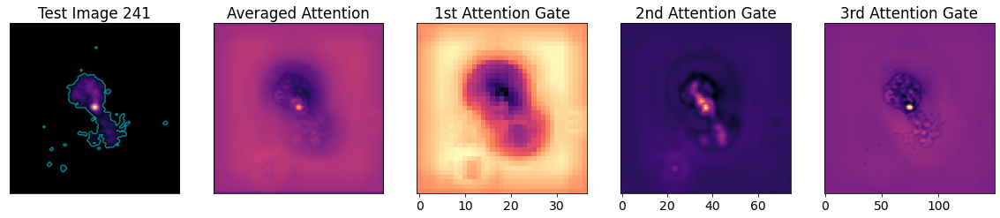

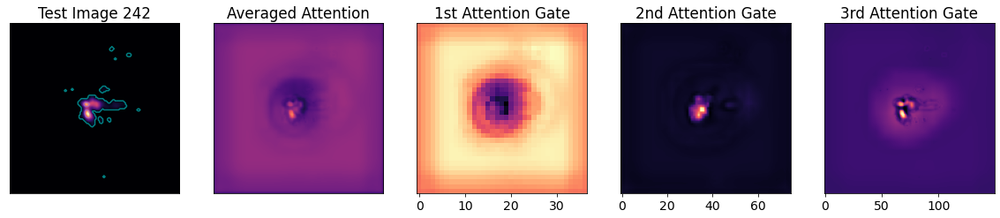

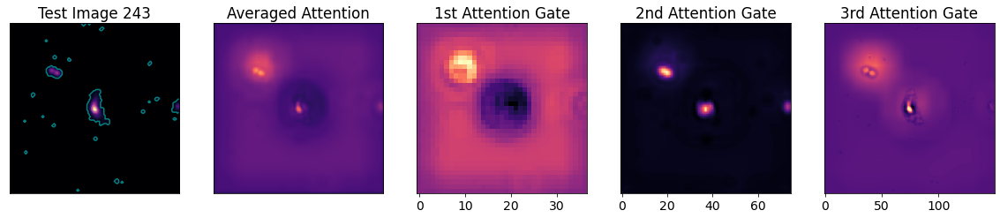

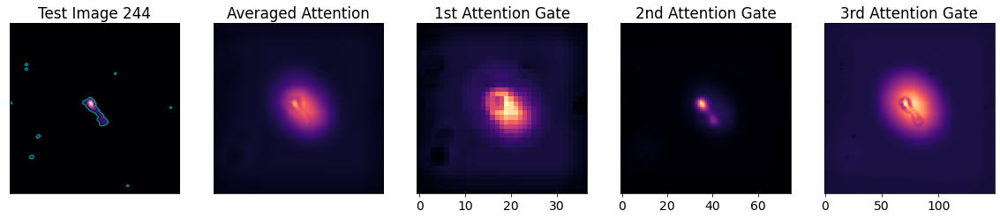

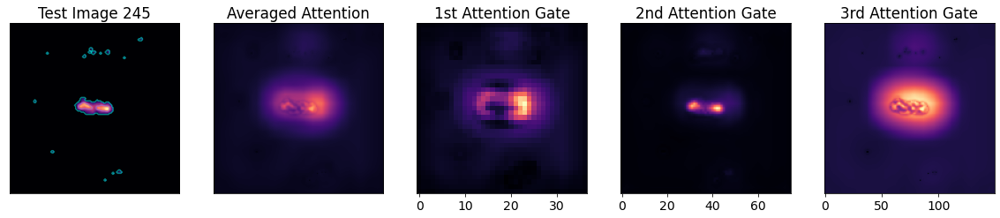

In [3]:
config_names = [
    #"bowles2021mirabest.cfg",
    #"scaife2021mirabest.cfg",
    "e2attentionmirabest.cfg",
    
    #"bowles2021mingo.cfg",
    #"scaife2021mingo.cfg", 
    "e2attentionmingo.cfg"
]

plot = 'all'
#plot = [3, 4, 5, 7, 9, 10, 17, 18, 22, 29]

for config_name in config_names:
    config_name = "configs/"+config_name
    print(config_name)
    config = ConfigParser.ConfigParser(allow_no_value=True)
    config.read(config_name)
    
    imap, fmap, test_data, predictions = attention_plot(config, path_supliment="", plot='all', fontsize=14, RGB=False, device=device)

configs/e2attentionmirabest.cfg
Files already downloaded and verified


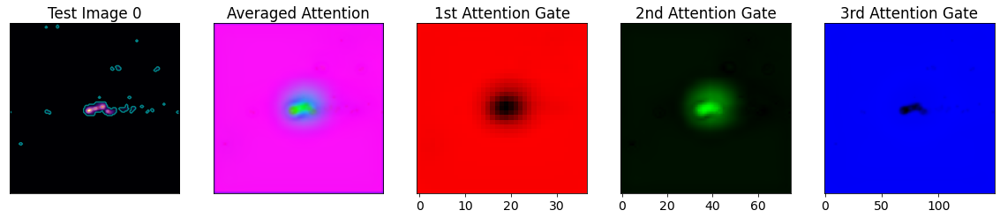

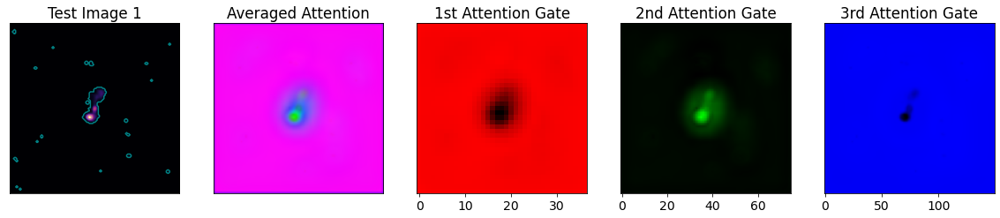

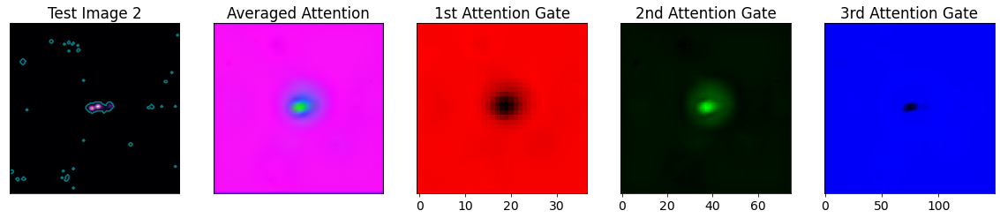

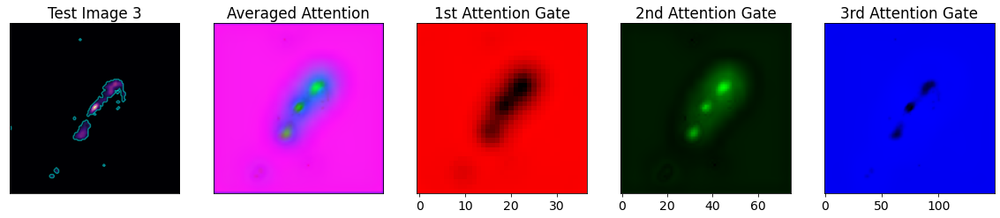

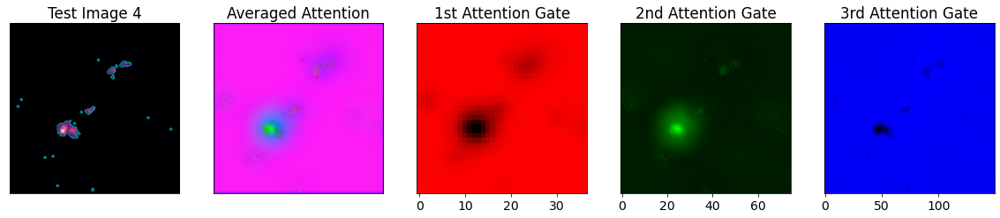

...

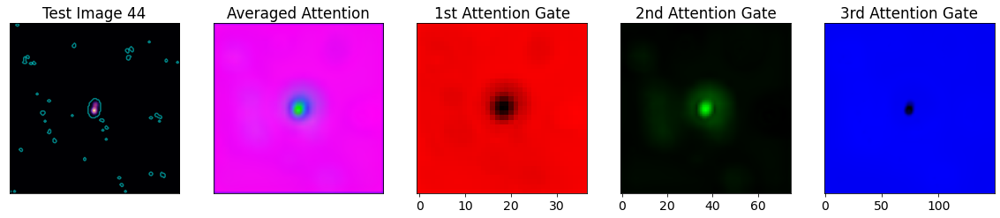

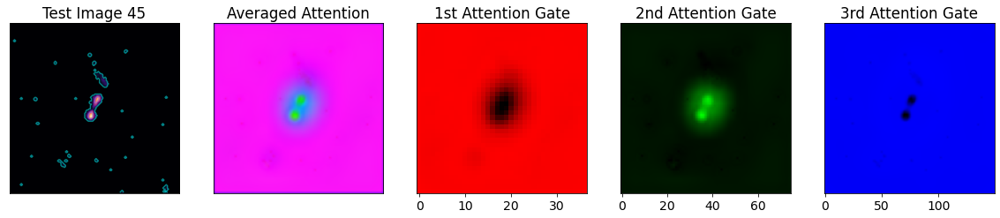

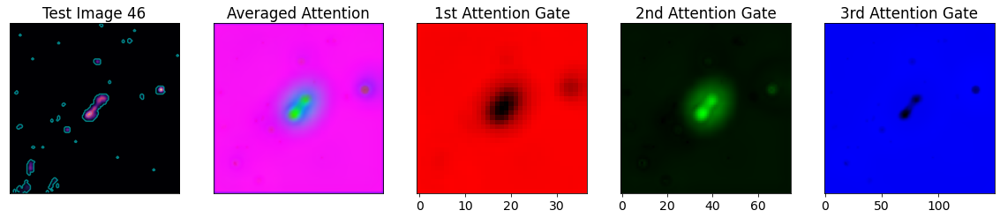

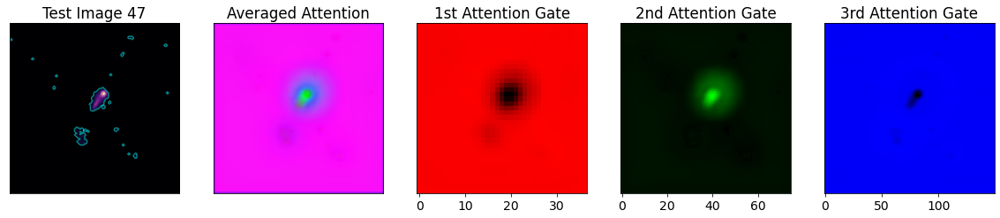

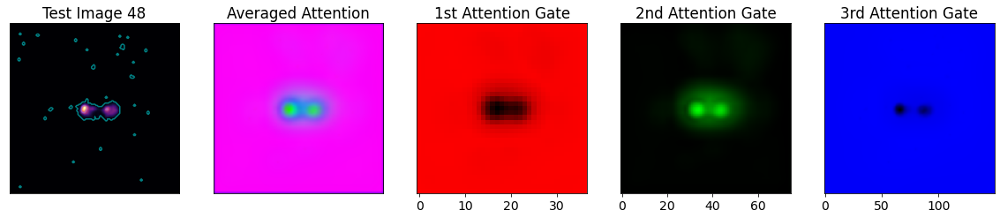

configs/e2attentionmingo.cfg
Files already downloaded and verified


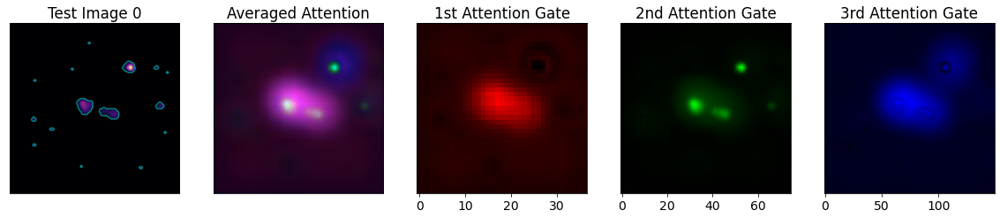

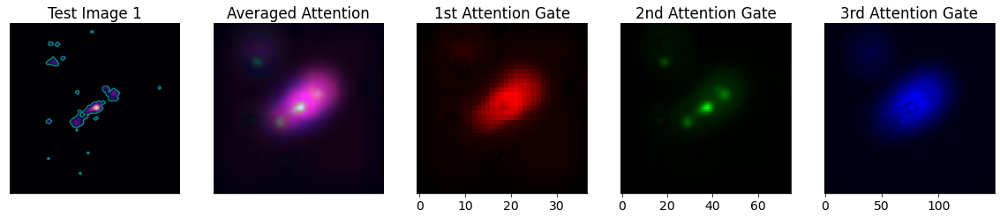

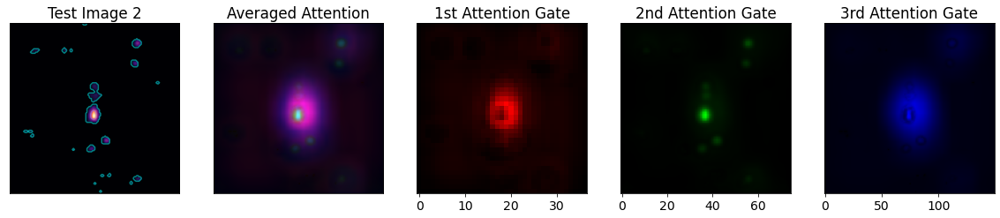

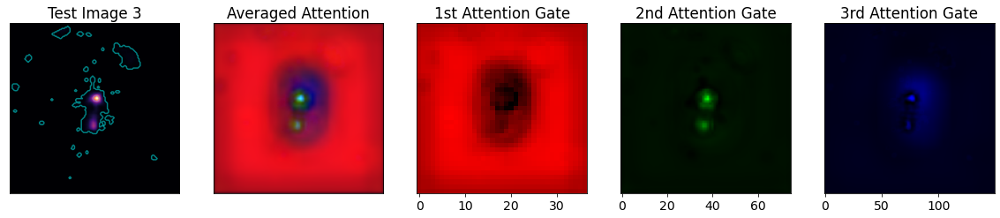

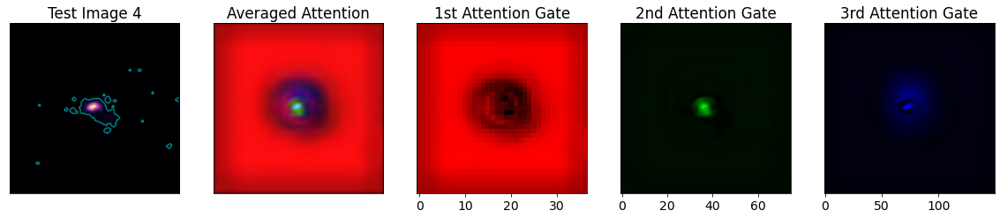

...

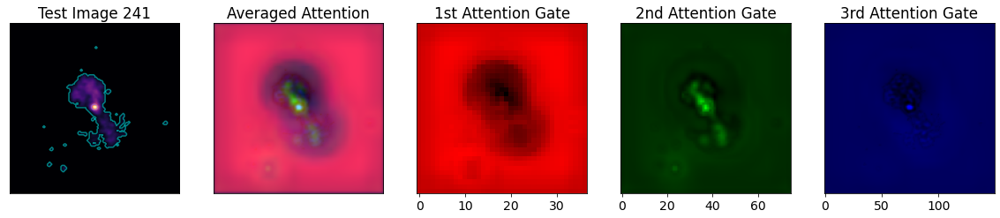

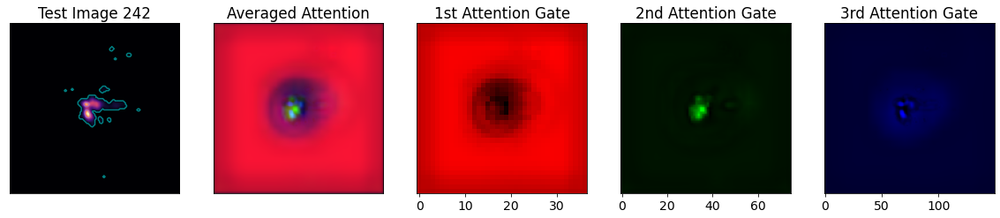

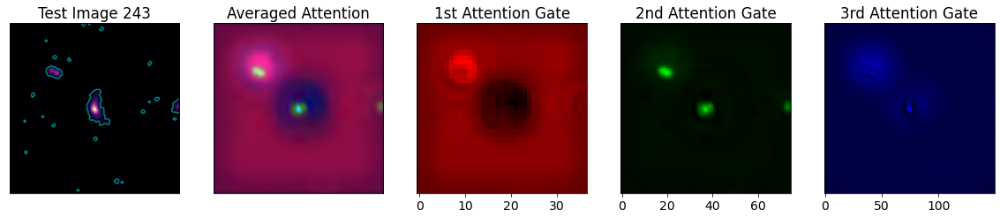

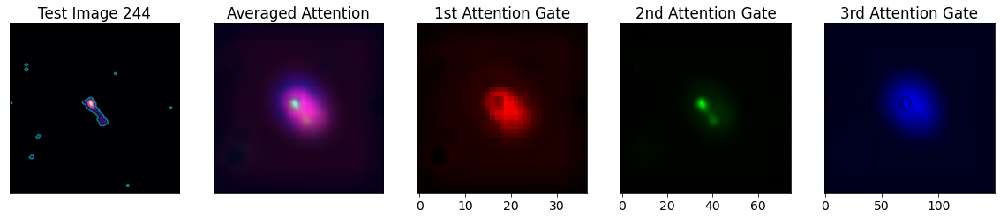

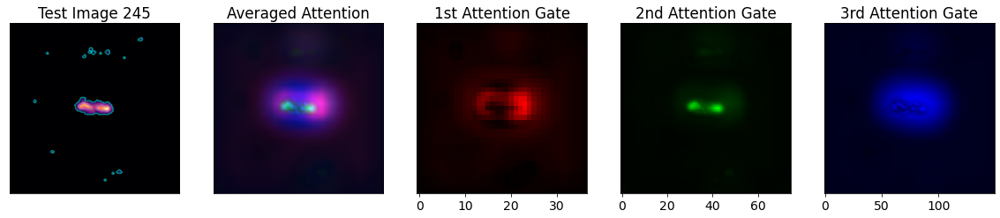

In [4]:
for config_name in config_names:
    config_name = "configs/"+config_name
    print(config_name)
    config = ConfigParser.ConfigParser(allow_no_value=True)
    config.read(config_name)
    
    imap, fmap, test_data, predictions = attention_plot(config, path_supliment="", plot=plot, fontsize=14, RGB=True, device=device)